# 项目介绍

非典与新冠疫情各自呈现怎样的传播过程？有何异同？两者感染率与致死率有何不同？为何新冠疫情的病例数量远超非典且并未像非典一样在短时间内得到控制？

本项目利用已获得的SARS数据和COVID-19数据，分析SARS和COVID-19两种疫情的蔓延过程，其中包含了对疫情发展的时间序列分析、疫情分布分析、各国疫情对比以及对疫情拐点的分析，既包含定量分析也包含定性分析。并且对疫情数据进行了可视化展示。

分别分析完两种疫情后，再项目的最后对SARS疫情与COVID-19疫情做了一个整体的比较，并在最后做出了总结

# 运行环境

本项目代码在以下环境中测试成功：（部分cell内由于计算量较大，可能速度较慢，但测试中并没有报错）
+ windows 10
+ python 3.7.1
+ jupyter notebook
  (注意，该项目中有动画展示内容，动画只有在网页版jupyter notebook才能有动画效果，本人在VScode中测试无法播放动画效果）

需要的第三方库及版本如下：

数据读取、处理：
+ numpy==1.19.3
+ geopandas==0.8.1
+ pandas==1.1.4

数据可视化:
+ matplotlib==3.3.3
+ plotly==4.12.0

# 数据集介绍

## SARS数据集

**sars_2003_complete_dataset_clean.csv**

**来源：**世界卫生组织:https://www.who.int/health-topics/severe-acute-respiratory-syndrome#tab=tab_1<br/></br>
**数据介绍：**数据中包含了自2003年3月17日至2003年7月11日每日各国SARS确诊病例总数、死亡病例数、治愈数（不包括未出现SARS病例的国家）

## COVID-19数据集

**1. covid_19_data.csv**<br/></br>
**来源：**Github: https://github.com/CSSEGISandData/COVID-19<br/></br>
**数据介绍:**数据中包含了自2020年1月22日至2020年12月06日每日世界各国各城市新冠确诊总数、死亡数、治愈病例数。（该数据仍在实时更新，项目下载该数据时更新到了2020年12月06日.)

**2.time_series_covid_19_confirmed.csv**<br/></br>
**来源:**Github: https://github.com/imdevskp/covid_19_jhu_data_web_scrap_and_cleaning<br></br>
**数据介绍**:数据中包含了自2020年1月22日至2020年12月06日每日世界各国新冠确诊总数，并且包含了地理经度、维度信息。（数据仍在实时更新，同上）

## 全球国家边界数据

**countries.geojson**<br/></br>
**来源:** Data.world: https://data.world/dgreiner/world-spatial-data<br/></br>
**数据介绍:**数据中包含了世界各国的国家边界的地理信息，以geojson格式保存。

In [1]:
# 导入相关的包
import warnings
import numpy as np
import pandas as pd
import geopandas as gpd
import plotly.express as px
from datetime import datetime
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots

warnings.filterwarnings('ignore')
plt.style.use("ggplot")
plt.rcParams['font.sans-serif'] = ['Microsoft Yahei']
plt.rcParams['font.serif'] = ['Microsoft Yahei']
plt.rcParams['axes.unicode_minus'] = False

# 1.  SARS疫情分析及可视化

In [2]:
# 读取数据
df_sar = pd.read_csv("./data/sars_2003_complete_dataset_clean.csv")
df_sar.head()

,Date,Country,Cumulative number of case(s),Number of deaths,Number recovered
0,2003-03-17,Germany,1,0,0
1,2003-03-17,Canada,8,2,0
2,2003-03-17,Singapore,20,0,0
3,2003-03-17,"Hong Kong SAR, China",95,1,0
4,2003-03-17,Switzerland,2,0,0


In [3]:
df_sar.tail()

,Date,Country,Cumulative number of case(s),Number of deaths,Number recovered
2533,2003-07-11,Switzerland,1,0,1
2534,2003-07-11,Thailand,9,2,7
2535,2003-07-11,United Kingdom,4,0,4
2536,2003-07-11,United States,75,0,67
2537,2003-07-11,Viet Nam,63,5,58


从以上的我们可以看出数据是描述从2003-03-17至2003-07-11每一天SARS新增病例、死亡病例以及治愈病例。
我们可以新增一列用来记录剩余感染人数

In [4]:
df_sar["Left"] = df_sar["Cumulative number of case(s)"] - df_sar["Number of deaths"] - df_sar["Number recovered"]
df_sar.head()

,Date,Country,Cumulative number of case(s),Number of deaths,Number recovered,Left
0,2003-03-17,Germany,1,0,0,1
1,2003-03-17,Canada,8,2,0,6
2,2003-03-17,Singapore,20,0,0,20
3,2003-03-17,"Hong Kong SAR, China",95,1,0,94
4,2003-03-17,Switzerland,2,0,0,2


接下来，我们统计不同国家总的累积病例并根据累积病例数量进行降序排列

In [5]:
df_sar_country = df_sar.groupby("Country").agg({"Cumulative number of case(s)":"max"})  # 分组并统计病例
df_sar_country = df_sar_country.reset_index()  # 在进行groupby聚合后dataframe的index仍然是原来的index,因此需要重新设置index
df_sar_country = df_sar_country.sort_values(by=["Cumulative number of case(s)"], ascending=False)
df_sar_country.head()

,Country,Cumulative number of case(s)
5,China,5329
10,"Hong Kong SAR, China",1755
32,"Taiwan, China",698
4,Canada,252
35,United States,220


In [6]:
fig = px.bar(df_sar_country, x="Country", y="Cumulative number of case(s)")
fig.show()

我们可以看到，中国累计病例最多，我们进一步分析，来看看中国的疫情

In [7]:
# 抽取中国的数据
df_sar_china = df_sar[(df_sar["Country"] == "China") & (df_sar["Cumulative number of case(s)"] > 0)]
df_sar_china.head()

,Date,Country,Cumulative number of case(s),Number of deaths,Number recovered,Left
102,2003-03-26,China,792,31,0,761
116,2003-03-27,China,806,34,0,772
131,2003-03-28,China,806,34,0,772
146,2003-03-29,China,806,34,0,772
161,2003-03-31,China,806,34,0,772


In [8]:
fig = px.line(df_sar_china, x="Date", y="Left")
fig.show()

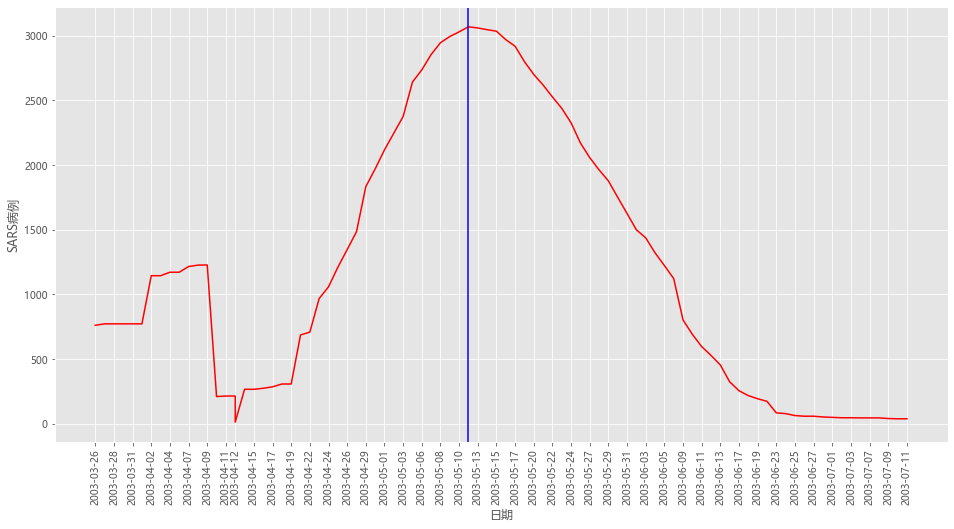

In [9]:
# 下面，为了更好的表示疫情发展，我们标注一下疫情拐点
max_index = df_sar_china[df_sar_china["Left"]==df_sar_china["Left"].max()].Date.values[0]

plt.figure(figsize=(16, 8))
plt.xticks(rotation=90)
index_x = df_sar_china["Date"].values
plt.plot(index_x, df_sar_china["Left"], color='r')
plt.axvline(x=max_index,ymin= 0, label='pyplot vertical line',color='b')
plt.xticks(index_x[::2])
plt.xlabel(u"日期")
plt.ylabel(u"SARS病例")
plt.show()

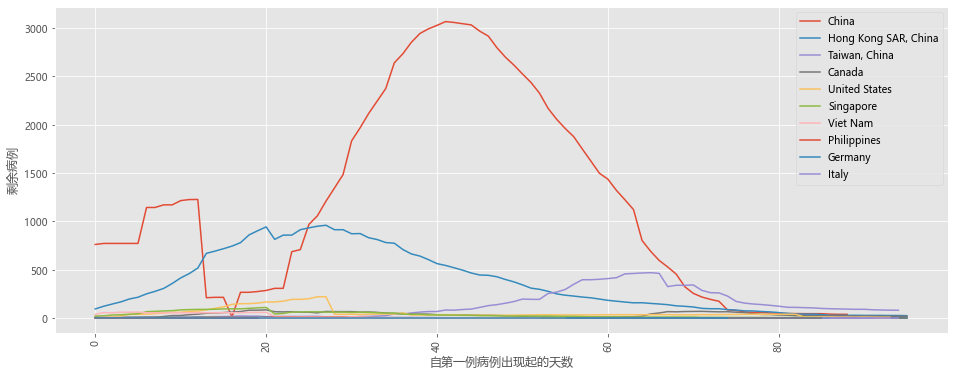

In [10]:
# 接着，我们对比一下病例数最多的前十个国家的SARS疫情发展趋势(起算时间为从第一例病例)
plt.figure(figsize=(16, 6))
plt.xticks(rotation=90)
for c in df_sar_country['Country'].values:
    plt.plot(df_sar[(df_sar['Country']== c) & (df_sar['Cumulative number of case(s)'] > 0)]['Left'].values)
plt.gca().legend(df_sar_country['Country'].values[0:0+10])
plt.xlabel(u"自第一例病例出现起的天数")
plt.ylabel(u"剩余病例")
plt.show()

由以上图表表明，大概在90天之后，各国几乎就无SARS病例

最终，我们通过绘图来更为直观的显示病例数、死亡数、病愈数的总体可视化显示。

In [11]:
# 提取数据
all_confirmed = df_sar.groupby('Date').sum()["Cumulative number of case(s)"].reset_index()
deaths = df_sar.groupby('Date').sum()["Number of deaths"].reset_index()
recovered = df_sar.groupby('Date').sum()["Number recovered"].reset_index()

# 绘图
fig = go.Figure()
fig.add_trace(go.Bar(x=all_confirmed["Date"], y=all_confirmed["Cumulative number of case(s)"], name="累积病例", marker_color="blue"))
fig.add_trace(go.Bar(x=deaths["Date"], y=deaths["Number of deaths"], name="死亡数", marker_color="red"))
fig.add_trace(go.Bar(x=recovered["Date"], y=recovered["Number recovered"], name="治愈数", marker_color="green"))
fig.update_layout(title="世界SARS疫情", xaxis_tickfont_size=14, yaxis=dict(title="人数", titlefont_size=16, tickfont_size=14),
                                                               legend=dict(x=0, y=1.0, bgcolor="rgba(255, 255, 255, 0)", 
                                                                                       bordercolor="rgba(255, 255, 255, 0)"),
                                                               barmode="group",
                                                               bargap=0.15,
                                                               bargroupgap=0.1,
)



为制作地图的可视化结果，但是SARS数据没有坐标信息，考虑导入国家数据与SARS数据的country字段建立联系

In [12]:
world_map = gpd.read_file(r"./data/countries.geojson")
world_map = world_map[world_map["name"] != "Antarctica"]
world_map.head()

,scalerank,featurecla,labelrank,sovereignt,sov_a3,adm0_dif,level,type,admin,adm0_a3,...,continent,region_un,subregion,region_wb,name_len,long_len,abbrev_len,tiny,homepart,geometry
0,3,Admin-0 country,5.0,Netherlands,NL1,1.0,2.0,Country,Aruba,ABW,...,North America,Americas,Caribbean,Latin America & Caribbean,5.0,5.0,5.0,4.0,-99.0,"POLYGON ((-69.89912 12.45200, -69.89570 12.423..."
1,1,Admin-0 country,3.0,Afghanistan,AFG,0.0,2.0,Sovereign country,Afghanistan,AFG,...,Asia,Asia,Southern Asia,South Asia,11.0,11.0,4.0,-99.0,1.0,"POLYGON ((74.89131 37.23164, 74.84023 37.22505..."
2,1,Admin-0 country,3.0,Angola,AGO,0.0,2.0,Sovereign country,Angola,AGO,...,Africa,Africa,Middle Africa,Sub-Saharan Africa,6.0,6.0,4.0,-99.0,1.0,"MULTIPOLYGON (((14.19082 -5.87598, 14.39863 -5..."
3,1,Admin-0 country,6.0,United Kingdom,GB1,1.0,2.0,Dependency,Anguilla,AIA,...,North America,Americas,Caribbean,Latin America & Caribbean,8.0,8.0,4.0,-99.0,-99.0,"POLYGON ((-63.00122 18.22178, -63.16001 18.171..."
4,1,Admin-0 country,6.0,Albania,ALB,0.0,2.0,Sovereign country,Albania,ALB,...,Europe,Europe,Southern Europe,Europe & Central Asia,7.0,7.0,4.0,-99.0,1.0,"POLYGON ((20.06396 42.54727, 20.10352 42.52466..."


In [13]:
# 提取有用的字段
world_map = world_map[["name", "continent", "geometry"]]
world_map.head()

,name,continent,geometry
0,Aruba,North America,"POLYGON ((-69.89912 12.45200, -69.89570 12.423..."
1,Afghanistan,Asia,"POLYGON ((74.89131 37.23164, 74.84023 37.22505..."
2,Angola,Africa,"MULTIPOLYGON (((14.19082 -5.87598, 14.39863 -5..."
3,Anguilla,North America,"POLYGON ((-63.00122 18.22178, -63.16001 18.171..."
4,Albania,Europe,"POLYGON ((20.06396 42.54727, 20.10352 42.52466..."


In [14]:
# 使名称一致
df_sar['Country'] = df_sar['Country'].replace('Hong Kong SAR, China', 'Hong Kong')
df_sar['Country'] = df_sar['Country'].replace('Macao SAR, China', 'Macao')
df_sar['Country'] = df_sar['Country'].replace('Republic of Ireland', 'Ireland')
df_sar['Country'] = df_sar['Country'].replace('Republic of Korea', 'Korea')
df_sar['Country'] = df_sar['Country'].replace('Russian Federation', 'Russia')
df_sar['Country'] = df_sar['Country'].replace('Taiwan, China', 'Taiwan')
df_sar['Country'] = df_sar['Country'].replace('Viet Nam', 'Vietnam')

# 先提取出SARS数据中存在的国家信息
sar_countries = world_map[world_map['name'].isin(df_sar['Country'].unique())]

# 拼接
df_sar_geo = pd.merge(df_sar, sar_countries, how="left", left_on="Country", right_on="name")

# 数据添加
df_sar_geo["lat"] = df_sar_geo["geometry"].values.centroid.y
df_sar_geo["lon"] = df_sar_geo["geometry"].values.centroid.x

In [15]:
df_sar_geo

,Date,Country,Cumulative number of case(s),Number of deaths,Number recovered,Left,name,continent,geometry,lat,lon
0,2003-03-17,Germany,1,0,0,1,Germany,Europe,"MULTIPOLYGON (((14.19824 53.91904, 14.21367 53...",51.106982,10.385780
1,2003-03-17,Canada,8,2,0,6,Canada,North America,"MULTIPOLYGON (((-59.78760 43.93960, -59.92227 ...",61.362063,-98.307770
2,2003-03-17,Singapore,20,0,0,20,Singapore,Asia,"POLYGON ((103.96973 1.33145, 103.81992 1.26538...",1.358761,103.817256
3,2003-03-17,Hong Kong,95,1,0,94,Hong Kong,Asia,"MULTIPOLYGON (((114.23203 22.21055, 114.20723 ...",22.398277,114.113805
4,2003-03-17,Switzerland,2,0,0,2,Switzerland,Europe,"POLYGON ((9.52402 47.52422, 9.55439 47.51113, ...",46.797859,8.208675
...,...,...,...,...,...,...,...,...,...,...,...
2533,2003-07-11,Switzerland,1,0,1,0,Switzerland,Europe,"POLYGON ((9.52402 47.52422, 9.55439 47.51113, ...",46.797859,8.208675
2534,2003-07-11,Thailand,9,2,7,0,Thailand,Asia,"MULTIPOLYGON (((99.66309 6.52192, 99.64404 6.5...",15.118158,101.002881
2535,2003-07-11,United Kingdom,4,0,4,0,United Kingdom,Europe,"MULTIPOLYGON (((-1.06558 50.69023, -1.14937 50...",54.123871,-2.865632
2536,2003-07-11,United States,75,0,67,8,United States,North America,"MULTIPOLYGON (((-155.58135 19.01201, -155.6256...",45.679547,-112.461674


In [16]:
# 制作动画
fig = px.density_mapbox(df_sar_geo,lat="lat", lon="lon", 
                        hover_name="Country", 
                        hover_data=["Cumulative number of case(s)", "Number of deaths", "Number recovered"],
                        animation_frame="Date",
                        color_continuous_scale="Portland",
                        radius=10,
                        zoom=0,
                        height=700)
fig.update_layout(title={"text":"世界SARS疫情变化","font":dict(family="Microsoft Yahei", size=18, color="#7f7f7f"), 
                            "xanchor":"center",
                            "yanchor":"top",
                            "y":0.97,
                            "x":0.5})
fig.update_layout(mapbox_style="open-street-map", mapbox_center_lon=0)                      
fig.update_layout(margin={"r":0, "t":40, "l":0, "b":0})
fig.show()

最后，画一幅树状图对比一下各国病例数量结束SARS的分析及可视化部分

In [17]:
def plot_treemap(dataframe, var, val):
    fig = px.treemap(dataframe.sort_values(by=val, ascending=False).reset_index(drop=True), 
                 path=[var], values=val, title='Country Wise No. of Cases',
                 color_discrete_sequence = px.colors.qualitative.Pastel1)
    fig.data[0].textinfo = 'label+text+value'
    fig.show()

In [18]:
fig = px.treemap(df_sar_country, path=["Country"], values="Cumulative number of case(s)", title="各国SARS病例数量", 
                color_discrete_sequence = px.colors.qualitative.Pastel1)
fig.data[0].textinfo = "label+text+value"
fig.show()

# COVID-19疫情分析及可视化

In [19]:
# 读取数据
df_covid = pd.read_csv("./data/covid_19_data.csv")

In [20]:
df_covid.tail()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered
172475,172476,12/06/2020,Zaporizhia Oblast,Ukraine,2020-12-07 05:26:14,36539.0,337.0,6556.0
172476,172477,12/06/2020,Zeeland,Netherlands,2020-12-07 05:26:14,6710.0,104.0,0.0
172477,172478,12/06/2020,Zhejiang,Mainland China,2020-12-07 05:26:14,1295.0,1.0,1288.0
172478,172479,12/06/2020,Zhytomyr Oblast,Ukraine,2020-12-07 05:26:14,31967.0,531.0,22263.0
172479,172480,12/06/2020,Zuid-Holland,Netherlands,2020-12-07 05:26:14,154813.0,2414.0,0.0


In [21]:
# 同样，计算一下剩余的病例
df_covid["Left"] = df_covid["Confirmed"] - df_covid["Deaths"] - df_covid["Recovered"]
df_covid.tail()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Left
172475,172476,12/06/2020,Zaporizhia Oblast,Ukraine,2020-12-07 05:26:14,36539.0,337.0,6556.0,29646.0
172476,172477,12/06/2020,Zeeland,Netherlands,2020-12-07 05:26:14,6710.0,104.0,0.0,6606.0
172477,172478,12/06/2020,Zhejiang,Mainland China,2020-12-07 05:26:14,1295.0,1.0,1288.0,6.0
172478,172479,12/06/2020,Zhytomyr Oblast,Ukraine,2020-12-07 05:26:14,31967.0,531.0,22263.0,9173.0
172479,172480,12/06/2020,Zuid-Holland,Netherlands,2020-12-07 05:26:14,154813.0,2414.0,0.0,152399.0


In [22]:
# 先画个图看一下整体的发展趋势
covid_date_agg = df_covid.groupby("ObservationDate")["Recovered", "Deaths", "Left"].sum().reset_index()
covid_date_agg = covid_date_agg.melt(id_vars="ObservationDate", 
                                     value_vars=['Recovered', 'Deaths', 'Left'],
                                     var_name='Case', 
                                     value_name='Count')
covid_date_agg.head()

,ObservationDate,Case,Count
0,01/22/2020,Recovered,28.0
1,01/23/2020,Recovered,30.0
2,01/24/2020,Recovered,36.0
3,01/25/2020,Recovered,39.0
4,01/26/2020,Recovered,52.0


In [23]:
fig = px.area(covid_date_agg, x="ObservationDate", y="Count", color="Case", 
               height=600, width=700, 
               title="新冠疫情",
               color_discrete_sequence = [ "#21bf73", "#ff2e63",  "#fe9801"])
fig.update_layout(xaxis_rangeslider_visible=True)
fig.show()

从上表看出，截至2020年12月6日世界上仍然有60M+新冠病例.新冠死亡率与病愈率相差不大。
接下来看下疫情的分布状况

In [24]:
df_covid_country = df_covid.groupby("Country/Region").sum()
df_covid_country = df_covid_country.sort_values(by="Confirmed", ascending=False)
df_covid_country.head()

,SNo,Confirmed,Deaths,Recovered,Left
Country/Region,,,,,
US,1203616394,1.281681e+09,38527689.0,454915009.0,788238103.0
India,700189085,8.336248e+08,13535890.0,712009431.0,108079496.0
Brazil,531637929,7.116181e+08,22422471.0,595123201.0,94072393.0
Russia,1601412534,2.242173e+08,3710729.0,164695487.0,55811104.0
France,227322858,1.454444e+08,7771781.0,21688397.0,115984257.0


如我们所想，截至2020年12月06日，感染人数最多为美国，确诊人数前5分别为：美国、印度、巴西、俄罗斯，法国.
接下来结合时间序列进行进一步分析.

In [25]:
fig = px.line(df_covid, x="ObservationDate", y="Confirmed",color='Country/Region', color_discrete_sequence = px.colors.cyclical.mygbm)
fig.update_layout(showlegend=True)
fig.show()

数据量有点大，让我们来做成动图，由于需要地理位置信息，这里在网站提供的数据里有带有坐标的时间序列数据，因此不用向SARS那样分析，直接引入分析。数据具体说明请看说明文档

In [26]:
time_series_geo_confirmed = pd.read_csv(r"./data/time_series_covid_19_confirmed.csv")
geo_confirmed_group = time_series_geo_confirmed.groupby(by="Country/Region", as_index=False).sum()
geo_confirmed_group.head()

,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,...,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,12/5/20,12/6/20
0,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,0,...,45723,45844,46116,46274,46516,46718,46837,46837,47072,47306
1,Albania,41.15330,20.168300,0,0,0,0,0,0,0,...,36245,36790,37625,38182,39014,39719,40501,41302,42148,42988
2,Algeria,28.03390,1.659600,0,0,0,0,0,0,0,...,80168,81212,82221,83199,84152,85084,85927,86730,87502,88252
3,Andorra,42.50630,1.521800,0,0,0,0,0,0,0,...,6610,6610,6712,6745,6790,6842,6904,6955,7005,7050
4,Angola,-11.20270,17.873900,0,0,0,0,0,0,0,...,15008,15087,15103,15139,15251,15319,15361,15493,15536,15591


In [27]:
geo_confirmed_sorted = geo_confirmed_group.sort_values(by=geo_confirmed_group.columns[-1], ascending=False)
geo_confirmed_sorted.head()    

,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,...,11/27/20,11/28/20,11/29/20,11/30/20,12/1/20,12/2/20,12/3/20,12/4/20,12/5/20,12/6/20
176,US,40.000000,-100.000000,1,1,2,2,5,5,5,...,13088821,13244701,13383370,13541221,13721858,13921913,14139577,14367462,14581337,14757000
79,India,20.593684,78.962880,0,0,0,0,0,0,0,...,9351109,9392919,9431691,9462809,9499413,9534964,9571559,9608211,9644222,9677203
23,Brazil,-14.235000,-51.925300,0,0,0,0,0,0,0,...,6238350,6290272,6314740,6335878,6386787,6436650,6487084,6533968,6577177,6603540
141,Russia,61.524010,105.318756,0,0,0,0,0,0,0,...,2196691,2223500,2249890,2275936,2302062,2327105,2354934,2382012,2410462,2439163
62,France,91.397395,60.040886,0,0,2,3,3,3,4,...,2248209,2260789,2270573,2274902,2283172,2297393,2310271,2321703,2334626,2345648


In [28]:
Number, Date, Country = [], [], []
for i in range(20):
    # 只选择确诊数最多的20个国家进行分析
    tree = []
    Number.extend(geo_confirmed_sorted[geo_confirmed_sorted.columns[3:]][i:i+1].T.values.tolist())
    Date.extend(geo_confirmed_sorted.columns[3:])
    tree.append(geo_confirmed_sorted.iloc[i,0])
    tree = tree * (geo_confirmed_sorted.shape[1]-3)
    Country.extend(tree)

In [29]:
print(len(Country), len(Date), len(Number))

6400 6400 6400


In [30]:
animation_result = pd.DataFrame(columns=["Date", "Number of case(s)", "Country"])
animation_result["Date"] = pd.DataFrame(Date)[0]
animation_result["Number of case(s)"] = pd.DataFrame(Number)[0]
animation_result["Country"] = pd.DataFrame(Country)[0]
animation_result.tail()

,Date,Number of case(s),Country
6395,12/2/20,549508,Indonesia
6396,12/3/20,557877,Indonesia
6397,12/4/20,563680,Indonesia
6398,12/5/20,569707,Indonesia
6399,12/6/20,575796,Indonesia


In [31]:
animation_fig = px.scatter_geo(animation_result, 
                               locations="Country", 
                               color="Country", 
                              locationmode="country names",
                              hover_name="Country",
                              size="Number of case(s)",
                              size_max=50,
                              animation_frame="Date",
                              projection="natural earth")
animation_fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 2
animation_fig.show()

从以上动画我们可以看到，大概是从3月底开始，世界各地的疫情爆发且增长速度激增。

接下来，我们重点研究剩余病例，分析各国疫情的发展（是否发生多次爆发、拐点等）

In [32]:
df_country_covid = df_covid.groupby(['ObservationDate','Country/Region']).agg({'Confirmed':'max','Deaths':'max','Recovered':'max','Left':'sum'}).reset_index()
df_country_covid = df_country_covid.replace(to_replace='Mainland China',value='China')
df_country_covid.head()

,ObservationDate,Country/Region,Confirmed,Deaths,Recovered,Left
0,01/22/2020,Hong Kong,0.0,0.0,0.0,0.0
1,01/22/2020,Japan,2.0,0.0,0.0,2.0
2,01/22/2020,Macau,1.0,0.0,0.0,1.0
3,01/22/2020,China,444.0,17.0,28.0,502.0
4,01/22/2020,South Korea,1.0,0.0,0.0,1.0


In [33]:
# 首先确认一下到目前为止，剩余病例最多的国家
top_left_by_country = df_covid.groupby(["Country/Region"]).agg({"Left":"max"}).reset_index()
top_left_by_country = top_left_by_country.replace(to_replace='Mainland China',value='China')
top_left_by_country = top_left_by_country.sort_values(by="Left", ascending=False)
top_left_by_country.head()

,Country/Region,Left
70,France,2089529.0
209,UK,1425527.0
210,US,1346745.0
43,Colombia,853900.0
20,Belgium,470503.0


很让人意外，虽然美国确诊最多，但是剩余病例却排第三，某种程度上表明美国的医疗说明还可以？

In [34]:
country_covid_remain=df_country_covid.pivot(index='ObservationDate',columns='Country/Region',values='Left').reset_index()
country_covid_remain=country_covid_remain.fillna(0)
country_covid_remain.head()

Country/Region,ObservationDate,Azerbaijan,"('St. Martin',)",Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,...,Vanuatu,Vatican City,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe,occupied Palestinian territory
0,01/22/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,01/23/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0
2,01/24/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0
3,01/25/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0
4,01/26/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0


In [35]:
fig = go.Figure()
for c in top_left_by_country["Country/Region"].values[0:11]:
    fig.add_trace(go.Scatter(x=country_covid_remain["ObservationDate"], y=country_covid_remain[c], mode="lines", 
                             name=c))
fig.update_layout(xaxis_title="日期", yaxis_title="剩余病例")
fig.show()

从剩余病例数可以看到，目前剩余病例前十的国家疫情增上大多放缓甚至开始下降。不过大多数据国家在9月份后开始出现再次爆发的状况（美国、印度、哥伦比亚、英国、波兰、西班牙...）

In [36]:
china_value = df_country_covid[(df_country_covid["Country/Region"] == "China") & (df_country_covid["Left"] > 0)]["Left"].values
fig = go.Figure(go.Scatter(y=china_value))
fig.update_layout(title="中国COVID剩余病例数量变化图", xaxis_title="自第一例病例发生起的时间",yaxis_title="剩余胜利数量")
fig.show()

与SARS疫情对比，中国在COVID疫情上虽然病例数较多，但是拐点发生时间比SARS要早。（COVID：27天，SARS：66天）。接下来看一下其他国家的疫情拐点（这里只计算剩余病例数量最多的那一天为拐点，因为考虑到多次爆发，这个统计结果只供参考）

In [37]:
# 这里只列出病例数量最多的前100个国家的数据
one_hundred_country = top_left_by_country.head(100)
peak_day = []
peak_date = []
peak_country = []
current_date = max(df_covid['ObservationDate'])  # 这里计算数据的最新时间，下面统计时不记录到目前为止都没有出现拐点的国家
for c in one_hundred_country["Country/Region"].values:
    peak_left = np.max(df_country_covid[df_country_covid["Country/Region"] == c]["Left"])
    peak_d = df_country_covid[(df_country_covid["Country/Region"]== c) & (df_country_covid["Left"] == peak_left)]["ObservationDate"].values[0]
    st_d = df_country_covid[(df_country_covid['Country/Region']==c)]['ObservationDate'].values[0]
    if ((datetime.strptime(current_date,'%m/%d/%Y')-datetime.strptime(peak_d,'%m/%d/%Y')).days)>= 14:  
        # 这里14天为界，拐点发生在当前时间14天以上的视为拐点
        peak_country.append(c)
        peak_day.append((datetime.strptime(peak_d,'%m/%d/%Y')-datetime.strptime(st_d,'%m/%d/%Y')).days)
        peak_date.append(peak_d)


In [38]:
# 拼接数据
peak_day = np.reshape(peak_day, (-1, 1))
peak_country = np.reshape(peak_country, (-1, 1))
peak_date = np.reshape(peak_date, (-1, 1))
result = np.concatenate((peak_country, peak_day, peak_date), axis=1)
result = pd.DataFrame(data=result, columns=["Country", "Peak Day", "Peak Date"])
result.head()

,Country,Peak Day,Peak Date
0,Colombia,281,10/30/2020
1,Peru,169,08/22/2020
2,India,231,09/17/2020
3,Brazil,277,10/26/2020
4,Chile,93,06/04/2020


In [39]:
result["Peak Day"] = result["Peak Day"].astype(np.uint8)

In [40]:
result = result.sort_values(by=["Peak Day"])
result

,Country,Peak Day,Peak Date
48,Luxembourg,2,11/13/2020
24,Morocco,2,11/15/2020
12,Portugal,2,11/15/2020
10,Jordan,2,11/16/2020
9,Switzerland,2,11/09/2020
14,Austria,7,11/14/2020
25,Nepal,16,10/23/2020
3,Brazil,21,10/26/2020
0,Colombia,25,10/30/2020
23,China,26,02/17/2020


In [41]:
fig = px.bar(result, x="Country", y="Peak Day", title="世界各地新冠疫情到达峰值的时间")
fig.show()

以上的表和图显示了各国疫情达到峰值花费的时间，从表中可以看出，虽然少数国家控制疫情速度比中国要快，但其都是在2020下半年才能够控制住疫情,中国是上半年唯一一个在短时间内控制住疫情的国家，且没有发生过大规模的二次爆发。

 接下来以确诊病例为研究对象，看一下中国和当前剩余病例前5国家的确诊病例数变化

In [42]:
df_date_sort_country = df_country_covid.sort_values(by="ObservationDate")

In [43]:
df_date_sort_country.head()

,ObservationDate,Country/Region,Confirmed,Deaths,Recovered,Left
0,01/22/2020,Hong Kong,0.0,0.0,0.0,0.0
1,01/22/2020,Japan,2.0,0.0,0.0,2.0
2,01/22/2020,Macau,1.0,0.0,0.0,1.0
3,01/22/2020,China,444.0,17.0,28.0,502.0
4,01/22/2020,South Korea,1.0,0.0,0.0,1.0


In [44]:
df_country_covid[df_country_covid["Country/Region"] == "France"]

,ObservationDate,Country/Region,Confirmed,Deaths,Recovered,Left
24,01/24/2020,France,2.0,0.0,0.0,2.0
36,01/25/2020,France,3.0,0.0,0.0,3.0
51,01/26/2020,France,3.0,0.0,0.0,3.0
67,01/27/2020,France,3.0,0.0,0.0,3.0
85,01/28/2020,France,4.0,0.0,0.0,4.0
...,...,...,...,...,...,...
52109,12/02/2020,France,2243251.0,53467.0,143092.0,2072290.0
52302,12/03/2020,France,2255912.0,53791.0,144469.0,2083466.0
52495,12/04/2020,France,2267019.0,54416.0,145324.0,2092858.0
52688,12/05/2020,France,2279869.0,54630.0,146330.0,2104561.0


In [45]:
country = ["UK", "US", "Colombia", "Belgium", "France"]
df_compare = df_date_sort_country[df_date_sort_country["Country/Region"] == "China"]
df_compare.drop(columns=["Left", "Deaths", "Recovered", "Country/Region"], inplace=True)
df_compare = pd.DataFrame(df_compare.Confirmed.values, index=df_compare["ObservationDate"].values, columns=["China"])

for c in country:
    df = df_date_sort_country[df_date_sort_country["Country/Region"] == c]
    df.drop(columns=["Left", "Deaths", "Recovered", "Country/Region"], inplace=True)
    df = pd.DataFrame(df.Confirmed.values, index=df["ObservationDate"].values, columns=[c])
    df_compare = df_compare.join(df, how="left")
df_compare.head()

,China,UK,US,Colombia,Belgium,France
01/22/2020,444.0,NaN,1.0,NaN,NaN,NaN
01/23/2020,444.0,NaN,1.0,0.0,NaN,NaN
01/24/2020,549.0,NaN,1.0,NaN,NaN,2.0
01/25/2020,761.0,NaN,1.0,NaN,NaN,3.0
01/26/2020,1058.0,NaN,2.0,NaN,NaN,3.0


In [46]:
df_compare.tail()

,China,UK,US,Colombia,Belgium,France
12/02/2020,68149.0,1426733.0,1268946.0,379902.0,94026.0,2243251.0
12/03/2020,68149.0,1438725.0,1286550.0,382704.0,94379.0,2255912.0
12/04/2020,68149.0,1452137.0,1310307.0,384260.0,94733.0,2267019.0
12/05/2020,68149.0,1464803.0,1337941.0,387418.0,95030.0,2279869.0
12/06/2020,68149.0,1479097.0,1366673.0,389136.0,95260.0,2290891.0


In [47]:
# Nan为没有病例的日子，补0
df_compare.fillna(0, inplace=True)
df_compare.head()

,China,UK,US,Colombia,Belgium,France
01/22/2020,444.0,0.0,1.0,0.0,0.0,0.0
01/23/2020,444.0,0.0,1.0,0.0,0.0,0.0
01/24/2020,549.0,0.0,1.0,0.0,0.0,2.0
01/25/2020,761.0,0.0,1.0,0.0,0.0,3.0
01/26/2020,1058.0,0.0,2.0,0.0,0.0,3.0


In [48]:
layout = go.Layout(
                   hovermode='x unified',
                   updatemenus=[
                        dict(
                            type='buttons', showactive=False,
                            y=0.8,
                            x=-0.07,
                            xanchor='right',
                            yanchor='top',
                            pad=dict(t=0, r=10),
                            buttons=[dict(label='Play',
                            method='animate',
                            args=[None, 
                                  dict(frame=dict(duration=1, 
                                                  redraw=False),
                                                  transition=dict(duration=0),
                                                  fromcurrent=True,
                                                  mode='immediate')]
                            )]
                        ),dict(
                            type = "buttons",
                            direction = "left",
                            buttons=list([
                                dict(
                                    args=[{"yaxis.type": "linear"}],
                                    label="LINEAR",
                                    method="relayout"
                                ),
                                dict(
                                    args=[{"yaxis.type": "log"}],
                                    label="LOG",
                                    method="relayout"
                                ),
                            ]),
                        ),
                    ]              
                  )

In [49]:
frames = [dict(data= [dict(type='scatter',
                           x=df_compare.index[:k+1],
                           y=df_compare['China'][:k+1]),
                      dict(type='scatter',
                           x=df_compare.index[:k+1],
                           y=df_compare['US'][:k+1]),
                      dict(type='scatter',
                           x=df_compare.index[:k+1],
                           y=df_compare["UK"][:k+1]),
                      dict(type='scatter',
                           x=df_compare.index[:k+1],
                           y=df_compare['Colombia'][:k+1]),
                      dict(type='scatter',
                           x=df_compare.index[:k+1],
                           y=df_compare['Belgium'][:k+1]),
                      dict(type='scatter',
                           x=df_compare.index[:k+1],
                           y=df_compare['France'][:k+1]),
                     ],
               traces= list(range(6)),  
              )for k  in  range(1, df_compare.shape[0])]


In [50]:
compare_country_fig = go.Figure(frames=frames, layout=layout)
for c in df_compare.columns[:6]:
    compare_country_fig.add_trace(go.Scatter(x = df_compare.index,
                y = df_compare[c],
                name = c,
            )
        )
compare_country_fig.update_xaxes(showticklabels=False)
compare_country_fig.show(config={"displayModeBar": False, "showTips": False})

上图进一步说明，目前剩余病例排在前5的中，美国、英国、法国经历了疫情二次爆发。
而哥伦比亚、比利时虽然目前剩余病例数量较多，但其疫情爆发是在近期，在上半年疫情较为平缓

最后，树状图结束该部分

In [51]:
df_finally = df_covid[["ObservationDate", "Country/Region", "Confirmed"]]
df_finally = df_covid.groupby(['ObservationDate', 'Country/Region'])['Confirmed']
df_finally = df_finally.sum().reset_index()
df_finally =  df_finally[df_finally['ObservationDate'] == max(df_finally['ObservationDate'])].reset_index()
df_finally = df_finally.groupby('Country/Region')['Confirmed'].sum().reset_index()
df_finally.head()

,Country/Region,Confirmed
0,Afghanistan,47306.0
1,Albania,42988.0
2,Algeria,88252.0
3,Andorra,7050.0
4,Angola,15591.0


In [52]:
fig = px.treemap(df_finally.sort_values(by="Confirmed", ascending=False).reset_index(drop=True),
                 path=["Country/Region"], values="Confirmed",
                color_discrete_sequence = px.colors.qualitative.Pastel1)
fig.data[0].textinfo = 'label+text+value'
fig.show()

# SARS和COVID-19比较

## 疫情分布对比

In [53]:
# 新冠
df_covid_distribute_analysis = df_covid.groupby(by=["ObservationDate", "Country/Region"]).sum().reset_index()

In [54]:
df_covid_distribute_analysis = df_covid_distribute_analysis[df_covid_distribute_analysis["ObservationDate"] == max(df_covid_distribute_analysis["ObservationDate"])]

In [55]:
df_covid_distribute_analysis.head()

,ObservationDate,Country/Region,SNo,Confirmed,Deaths,Recovered,Left
52821,12/06/2020,Afghanistan,171721,47306.0,1874.0,37685.0,7747.0
52822,12/06/2020,Albania,171722,42988.0,905.0,21617.0,20466.0
52823,12/06/2020,Algeria,171723,88252.0,2516.0,57146.0,28590.0
52824,12/06/2020,Andorra,171724,7050.0,78.0,6238.0,734.0
52825,12/06/2020,Angola,171725,15591.0,354.0,8338.0,6899.0


In [56]:
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('South Korea', 'Korea')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('US', 'United States')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Taiwan*', 'Taiwan')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Antigua and Barbuda', 'Antigua and Barb.')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Bosnia and Herzegovina', 'Bosnia and Herz.')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Burma', 'Myanmar')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Central African Republic', 'Central African Rep.')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Dominican Republic', 'Dominican Rep.')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Equatorial Guinea', 'Eq. Guinea')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Laos', 'Lao PDR')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Saint Kitts and Nevis', 'St. Kitts and Nevis')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Saint Vincent and the Grenadines', 'St. Vin. and Gren.')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Western Sahara', 'W. Sahara')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Cabo Verde', 'Cape Verde')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Congo (Kinshasa)', 'Dem. Rep. Congo')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Sao Tome and Principe', 'São Tomé and Principe')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Eswatini', 'Swaziland')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace("Cote d'Ivoire", "Côte d'Ivoire")
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('South Sudan', 'S. Sudan')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Czechia', 'Czech Rep.')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('North Macedonia', 'Macedonia')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Congo (Brazzaville)', 'Congo')
df_covid_distribute_analysis['Country/Region'] = df_covid_distribute_analysis['Country/Region'].replace('Mainland China', 'China')

In [57]:
fig = px.choropleth(df_covid_distribute_analysis, locations=df_covid_distribute_analysis["Country/Region"], color="Confirmed",
                    locationmode="country names",color_continuous_scale="matter",
                    hover_name="Country/Region", hover_data=["Confirmed"],
                   title="全球新冠病毒确诊病例数（截至2020年12月6日）")
fig.show()

In [58]:
# SARS
df_sar.head()

,Date,Country,Cumulative number of case(s),Number of deaths,Number recovered,Left
0,2003-03-17,Germany,1,0,0,1
1,2003-03-17,Canada,8,2,0,6
2,2003-03-17,Singapore,20,0,0,20
3,2003-03-17,Hong Kong,95,1,0,94
4,2003-03-17,Switzerland,2,0,0,2


In [59]:
df_sar_distribute_analysis = df_sar.groupby(by="Country").sum().reset_index()
df_sar_distribute_analysis.tail()

,Country,Cumulative number of case(s),Number of deaths,Number recovered,Left
32,Taiwan,30373,3550,14367,12456
33,Thailand,697,167,428,102
34,United Kingdom,414,0,330,84
35,United States,7206,0,2245,4961
36,Vietnam,5885,438,4116,1331


In [60]:
fig = px.choropleth(df_sar_distribute_analysis, locations=df_sar_distribute_analysis["Country"], color="Cumulative number of case(s)",
                    locationmode="country names",color_continuous_scale="matter",
                    hover_name="Country", hover_data=["Cumulative number of case(s)"],
                   title="全球SARS病毒确诊病例数")
fig.show()

In [61]:
covid_top_10 = df_covid_distribute_analysis.sort_values(by="Confirmed", ascending=False).head(10)

In [62]:
covid_top_10.head()

,ObservationDate,Country/Region,SNo,Confirmed,Deaths,Recovered,Left
53000,12/06/2020,United States,9987689,14757000.0,282299.0,5624444.0,8850257.0
52899,12/06/2020,India,6370326,9677203.0,140573.0,9139901.0,396729.0
52844,12/06/2020,Brazil,4648893,6603540.0,176941.0,5866657.0,559942.0
52963,12/06/2020,Russia,14293198,2439163.0,42675.0,1920744.0,475744.0
52881,12/06/2020,France,1893885,2345648.0,55247.0,175220.0,2115181.0


In [63]:
fig = make_subplots(rows=2, cols=1, specs=[[{"type": "choropleth"}],[{"type": "bar"}]])
fig.add_trace(go.Choropleth(locations=df_covid_distribute_analysis["Country/Region"], z=df_covid_distribute_analysis["Confirmed"],
                           locationmode="country names", colorscale="matter"), row=1, col=1)
fig.add_trace(go.Bar(x=covid_top_10["Country/Region"].values, y=covid_top_10["Confirmed"].values, marker_color='indianred'), row=2, col=1)


In [64]:
sar_top_10 = df_sar_distribute_analysis.sort_values(by="Cumulative number of case(s)", ascending=False).head(10)
sar_top_10.head()

,Country,Cumulative number of case(s),Number of deaths,Number recovered,Left
5,China,343093,19738,216323,107032
10,Hong Kong,132776,16924,80211,35641
32,Taiwan,30373,3550,14367,12456
26,Singapore,16428,2052,11206,3170
4,Canada,14249,2015,8752,3482


In [65]:
fig = make_subplots(rows=2, cols=1, specs=[[{"type": "choropleth"}],[{"type": "bar"}]])
fig.add_trace(go.Choropleth(locations=df_sar_distribute_analysis["Country"], z=df_sar_distribute_analysis["Cumulative number of case(s)"],
                           locationmode="country names", colorscale="matter"), row=1, col=1)
fig.add_trace(go.Bar(x=sar_top_10["Country"].values, y=sar_top_10["Cumulative number of case(s)"].values, marker_color='indianred'), row=2, col=1)

从以上图表中我们可以发现，SARS病例主要分布在中国，而新观病毒高发地则为北美、非洲、印度等地。

## 感染国家数量

In [66]:
fig = make_subplots(rows=1, cols=2, specs=[[{"type": "bar"},{"type": "pie"}]])
fig.add_trace(go.Bar(x=["COVID-19", "SARS"],
                    y=[df_covid_distribute_analysis["Country/Region"].nunique(), df_sar_distribute_analysis["Country"].nunique()],
                   marker_color=["#636EFA", "#EF553B"]), row=1, col=1)
fig.add_trace(go.Pie(labels=["COVID-19", "SARS"],
                   values=[df_covid_distribute_analysis["Country/Region"].nunique(), df_sar_distribute_analysis["Country"].nunique()],
                   textinfo='label+value', 
                   insidetextorientation='radial',
                   marker_colors=["#636EFA", "#EF553B"],
                   pull=[0.2, 0]), row=1, col=2)
fig.update(layout_title_text="新冠病毒和SARS病毒感染国家数量",
           layout_showlegend=False)
fig.show()


如预想的一样，新观病毒分布的范围远超SARS病毒

## 恢复病例/死亡病例

In [67]:
colos = ["#00CC96", "#EF553B", "#636EFA"]
fig = make_subplots(rows=1, cols=2, specs=[[{"type": "pie"},{"type": "pie"}]], subplot_titles=["COVID-19", "SARS"])
fig.add_trace(go.Pie(labels=["治愈病例","死亡病例","现存病例"],
                   values=[df_covid_distribute_analysis["Recovered"].sum(), 
                           df_covid_distribute_analysis["Deaths"].sum(), 
                           df_covid_distribute_analysis["Left"].sum()],
                   textinfo='label+percent', 
                   insidetextorientation='radial',
                   marker_colors=colos,
                   pull=[0.2, 0, 0]), row=1, col=1)
fig.add_trace(go.Pie(labels=["治愈病例", "死亡病例"],
                   values=[df_sar_distribute_analysis["Number recovered"].sum(), 
                           df_sar_distribute_analysis["Number of deaths"].sum()],
                   textinfo='label+percent', 
                   insidetextorientation='radial',
                   marker_colors=colos[:2],
                   pull=[0.2, 0]), row=1, col=2)
fig.show()

相对而言，COVID死亡率较低.SARS虽然治愈病例相较COVID较高，但由于COVID仍存在大量的现存病例，无法直接进行比较。但是COVID在如此大面积感染的情况下仍能保持低死亡率，说明其死亡率确实应该比SARS要低。其可能的原因可能有：1.医疗水平提升。 2.COVID病毒虽然感染性较强，但杀伤性不强。

## 百分比比较

In [68]:
# covid
covid_death_percent = df_covid_distribute_analysis["Deaths"].sum() / df_covid_distribute_analysis["Confirmed"].sum() * 100
covid_recover_percent = df_covid_distribute_analysis["Recovered"].sum() / df_covid_distribute_analysis["Confirmed"].sum() * 100
covid_infected_country_percent = df_covid_distribute_analysis["Country/Region"].nunique() / world_map["name"].nunique() * 100

# sars
sar_death_percent = df_sar_distribute_analysis["Number of deaths"].sum() / df_sar_distribute_analysis["Cumulative number of case(s)"].sum() * 100
sar_recover_percent = df_sar_distribute_analysis["Number recovered"].sum() / df_sar_distribute_analysis["Cumulative number of case(s)"].sum() * 100
sar_infected_country_percent = df_sar_distribute_analysis["Country"].nunique() / world_map["name"].nunique() * 100


In [69]:
name = ["死亡率", "治愈率", "感染国家占全球国家总数的比率"]
fig = go.Figure()
fig.add_trace(go.Bar(
    x=name,
    y=[covid_death_percent, covid_recover_percent, covid_infected_country_percent],
    name='COVID-19',
))

fig.add_trace(go.Bar(
    x=name,
    y=[sar_death_percent, sar_recover_percent, sar_infected_country_percent],
    name='SARS',
))
fig.update_layout(title="COVID-19与SARS整体比较",yaxis_title="百分比(%)")
fig.show()

通过以上比较得出：
+ COVID-19感染范围更广，感染性更高
+ COVID-19的致死率相较SARS而言较低

# 总结

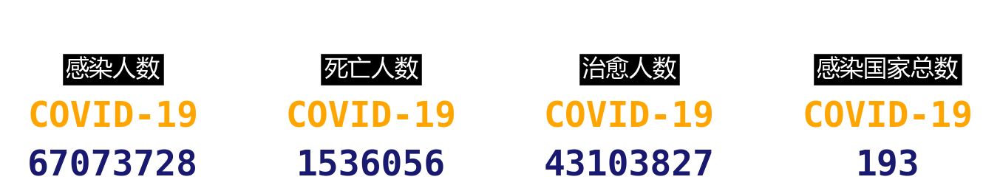

In [70]:
name = ["感染人数", "死亡人数", "治愈人数", "感染国家总数"]

fig, axes = plt.subplots(1, 4, figsize=(24, 4))
axes = axes.flatten()
covid_summary = [df_covid_distribute_analysis["Confirmed"].sum(),
                   df_covid_distribute_analysis["Deaths"].sum(),
                  df_covid_distribute_analysis["Recovered"].sum(),
                  df_covid_distribute_analysis["Country/Region"].nunique()]

for ind, col in enumerate(name):
    axes[ind].text(0.5, 0.6, col, 
            ha='center', va='center',
            fontfamily='Microsoft Yahei', fontsize=32, 
            color='white', backgroundcolor='black')
    
    axes[ind].text(0.5, 0.3, 'COVID-19', 
        ha='center', va='center',
        fontfamily='monospace', fontsize=48, fontweight='bold',
        color="orange", backgroundcolor='white')
    
    axes[ind].text(0.5, 0, int(covid_summary[ind]), 
            ha='center', va='center',
            fontfamily='monospace', fontsize=48, fontweight='bold',
            color="midnightblue", backgroundcolor='white')

    axes[ind].set_axis_off()

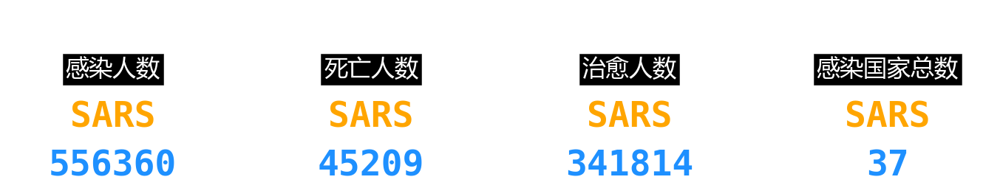

In [71]:
fig, axes = plt.subplots(1, 4, figsize=(24, 4))
axes = axes.flatten()
sars_summary = [df_sar_distribute_analysis["Cumulative number of case(s)"].sum(),
                df_sar_distribute_analysis["Number of deaths"].sum(),
                df_sar_distribute_analysis["Number recovered"].sum(),
                df_sar_distribute_analysis["Country"].nunique()]

for ind, col in enumerate(name):
    axes[ind].text(0.5, 0.6, col, 
            ha='center', va='center',
            fontfamily='Microsoft Yahei', fontsize=32, 
            color='white', backgroundcolor='black')
    
    axes[ind].text(0.5, 0.3, 'SARS', 
        ha='center', va='center',
        fontfamily='monospace', fontsize=48, fontweight='bold',
        color="orange", backgroundcolor='white')
    
    axes[ind].text(0.5, 0, int(sars_summary[ind]), 
            ha='center', va='center',
            fontfamily='monospace', fontsize=48, fontweight='bold',
            color="dodgerblue", backgroundcolor='white')

    axes[ind].set_axis_off()


1. SARS疫情高发地区为中国，其感染面积相对较小且在较短时间内得到了控制，其疫情拐点距离第一例病例被发现约66天。
2. COVID-19疫情感染面积几乎覆盖全球，中国疫情拐点距第一例病例被发现约26天。但是大多数国家并没有迎来真正意义上的疫情拐点并有多次爆发的现象。
3. SARS疫情高峰出现在东亚地区，COVID-19疫情高峰目前在北美、欧洲、非洲、南亚地区。
4. COVID-19与SARS相比，虽然其无论是在感染数量还是感染范围都远超后者，但其相对死亡率较低。
5. COVID-19感染面积、国家数量远超SARS，因而导致感染人数较多，由多次爆发的现象可以看出，COVID-19未像SARS一样在短时间内得到控制的原因在于未能够做好长期严格的疫情防控措施，导致旧病例未完全清零而爆发新一轮病例。同时，猜测一部分原因由于与SARS爆发时期相比，COVID-19爆发时期交通运输流量更大，人口流动更多。


# 后续工作

1. 可以在本研究的基础上进一步获得疫情期间的交通流动数据，分析交通流动与疫情爆发之间的关系。
2. 获取各国采取相应疫情防控措施的时间点，分析前后疫情爆发的差异，从而分析不同疫情防控措施所带来的效益，为防控疫情制定措施提供一定的依据。